In [1]:
%load_ext autoreload
%autoreload 2

In [7]:
from SHDataset import SHDataset
from utils import *
from metrics import *

dataset = SHDataset(noise=False)

In [3]:
G1,T1,G2,T2 = dataset.read_snapshots(0, bbox=(52.34, 52.35, 4.89, 4.93))

In [4]:
from models.hmm import HMMChangeDetector

hmm_det = HMMChangeDetector(G1)

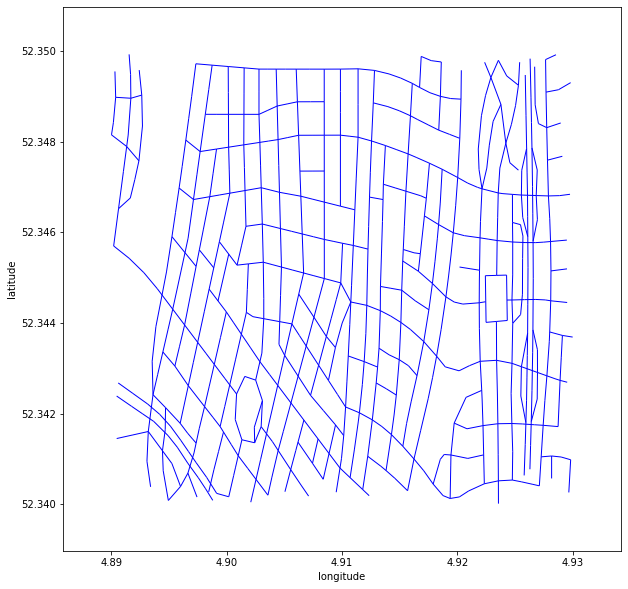

In [5]:
plot_graph(G1, figsize=(10,10))

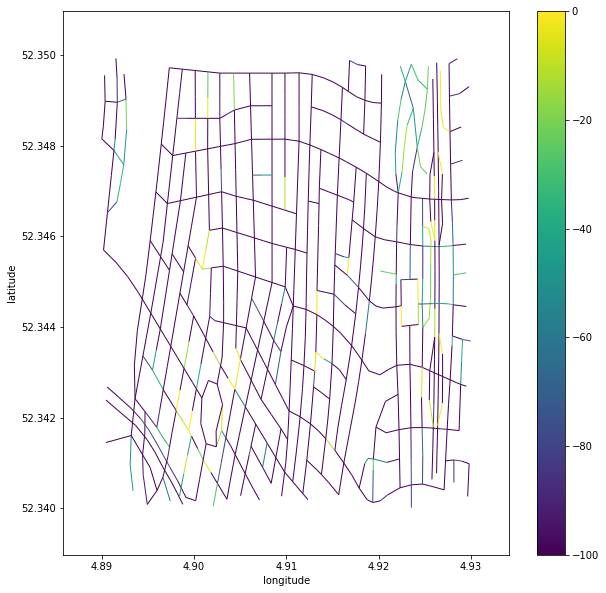

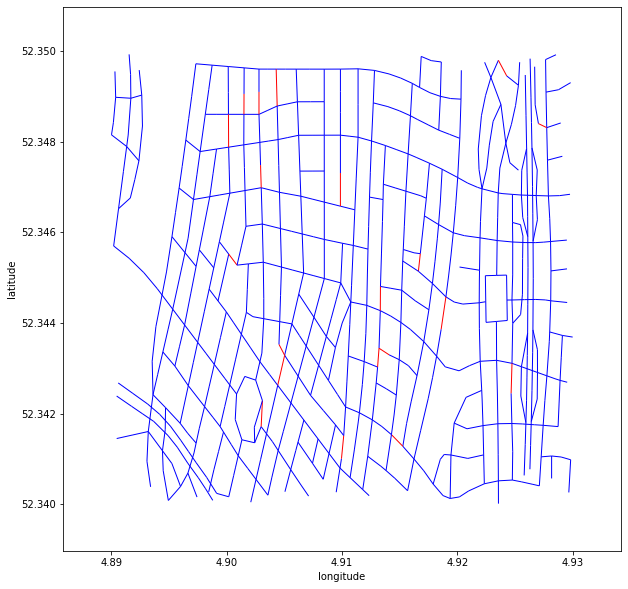

In [23]:
import pickle5 as pkl
import os

def read_hmm_scores(folder='results_high_sample_v3', noise_config=0):
    subfolders = sorted([os.path.join(folder, f) for f in os.listdir(folder) if os.path.isdir(os.path.join(folder, f))])
    folder = subfolders[noise_config]
    results = [os.path.join(folder, f) for f in os.listdir(folder) if 'hdf5' in f]
    if len(results) != 1:
        raise ValueError(f"Expected one results file (hdf5) in {results_folder}, but found {len(files)}: {files}")
    results_file = results[0]
    with open(results_file, 'rb') as handle:
        result = pkl.load(handle)
    
    scores = result['results']['hmm']['scores']
    
    return scores

def read_rb_scores(folder='results_high_sample_v3', noise_config=0):
    subfolders = sorted([os.path.join(folder, f) for f in os.listdir(folder) if os.path.isdir(os.path.join(folder, f))])
    folder = subfolders[noise_config]
    results = [os.path.join(folder, f) for f in os.listdir(folder) if 'hdf5' in f]
    if len(results) != 1:
        raise ValueError(f"Expected one results file (hdf5) in {results_folder}, but found {len(files)}: {files}")
    results_file = results[0]
    with open(results_file, 'rb') as handle:
        result = pkl.load(handle)
    
    scores = result['results']['rulebased']['scores']
    
    return scores

gt_labels = groundtruth_labels(G1, G2)
    
scores_hmm = read_hmm_scores()
scores_hmm = {edge: v if v > -100 else -100 for edge, v in scores_hmm.items()}
G1_weighted = G1.copy()
nx.set_edge_attributes(G1_weighted, scores_hmm, name='weight')
plot_graph(G1_weighted, figsize=(10,10), use_weights=True)
_, G12_d, _,_ = compare_snapshots(G1, G2)
plot_graph(G12_d, figsize=(10,10))

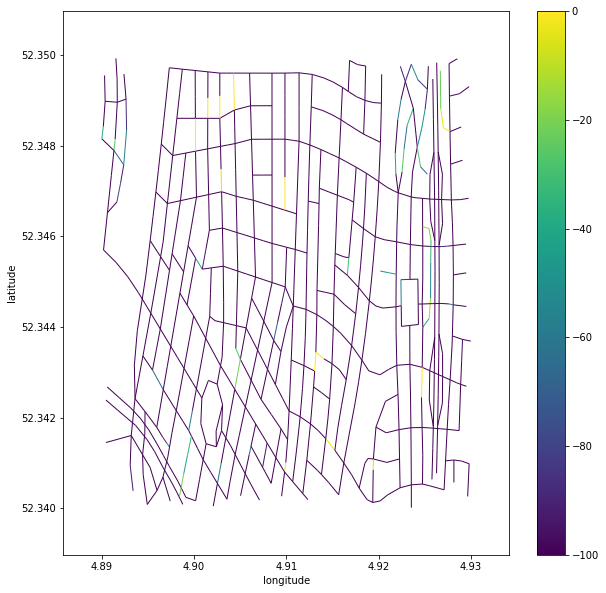

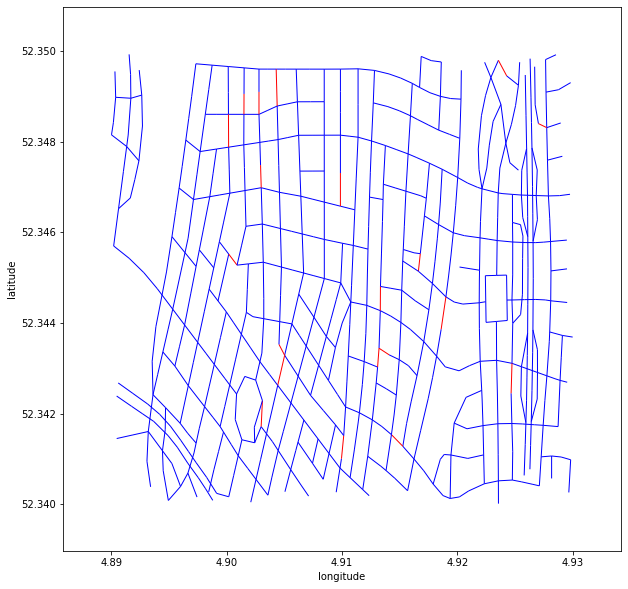

In [24]:
scores_rb = read_rb_scores()
scores_rb = {edge: v if v > -100 else -100 for edge, v in scores_rb.items()}
G1_weighted = G1.copy()
nx.set_edge_attributes(G1_weighted, scores_rb, name='weight')
plot_graph(G1_weighted, figsize=(10,10), use_weights=True)
_, G12_d, _,_ = compare_snapshots(G1, G2)
plot_graph(G12_d, figsize=(10,10))

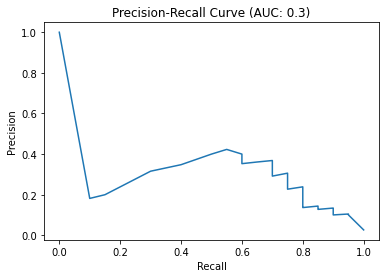

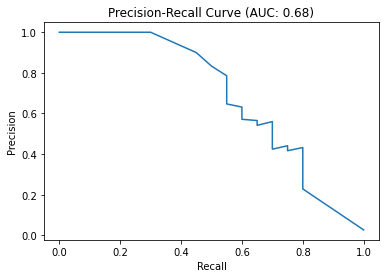

(array([0.02670227, 0.22857143, 0.23188406, 0.24242424, 0.24615385,
        0.26666667, 0.27118644, 0.28070175, 0.29090909, 0.2962963 ,
        0.30188679, 0.30769231, 0.31372549, 0.32      , 0.33333333,
        0.34042553, 0.34782609, 0.35555556, 0.36363636, 0.37209302,
        0.38095238, 0.3902439 , 0.4       , 0.41025641, 0.42105263,
        0.43243243, 0.41666667, 0.42857143, 0.44117647, 0.42424242,
        0.4375    , 0.4516129 , 0.46666667, 0.48275862, 0.5       ,
        0.51851852, 0.53846154, 0.56      , 0.54166667, 0.56521739,
        0.57142857, 0.6       , 0.63157895, 0.64705882, 0.6875    ,
        0.73333333, 0.78571429, 0.83333333, 0.9       , 1.        ,
        1.        ]),
 array([1.  , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 ,
        0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 , 0.8 ,
        0.8 , 0.8 , 0.8 , 0.8 , 0.75, 0.75, 0.75, 0.7 , 0.7 , 0.7 , 0.7 ,
        0.7 , 0.7 , 0.7 , 0.7 , 0.7 , 0.65, 0.65, 0.6 , 0.6 , 0.6 , 0.55,
  

In [25]:
from metrics import *

PRCurve(gt_labels, scores_hmm, log_scale=False)
PRCurve(gt_labels, scores_rb, log_scale=False)

In [11]:
gt_labels.keys() == scores_hmm.keys()

True

In [12]:
removed_roads = [edge for edge, v in gt_labels.items() if v == 1.0]

In [20]:
print(f'hmm scores for removed edges: {[scores_hmm[edge] for edge in removed_roads]}')
print(f'Sum of removed edges scores for hmm: {sum([scores_hmm[edge] for edge in removed_roads])}')

hmm scores for removed edges: [-11, -12, -2, -18, -62, -150, -3, 0, -30, -1, -4, -75, -6, -3, -4, -95, -2, -5, -2, 0]
Sum of removed edges scores for hmm: -485


In [22]:
print(f'rb scores for removed edges: {[scores_rb[edge] for edge in removed_roads]}')
print(f'Sum of removed edges scores for rb: {sum([scores_rb[edge] for edge in removed_roads])}')

rb scores for removed edges: [-4, 0, -1, 0, -834, -424, -44, -1, -51, -1, -420, -5, 0, -21, -26, 0, 0, 0, -261, -30]
Sum of removed edges scores for rb: -2123


In [ ]:
PRCurve(gt_labels, gt_labels, log_scale=False)

In [ ]:

ex = {k: int(gt_labels[k] == 0) for k in gt_labels}

In [27]:
removed_roads

[(236, 14871),
 (281, 4027),
 (2324, 10744),
 (3706, 19082),
 (5930, 8139),
 (6032, 32487),
 (6187, 16452),
 (8904, 27195),
 (9309, 12765),
 (9998, 20930),
 (11028, 29027),
 (12798, 23344),
 (14829, 24187),
 (18387, 19620),
 (18387, 21160),
 (18611, 20155),
 (20362, 28265),
 (20930, 32040),
 (21793, 26271),
 (22942, 24913)]

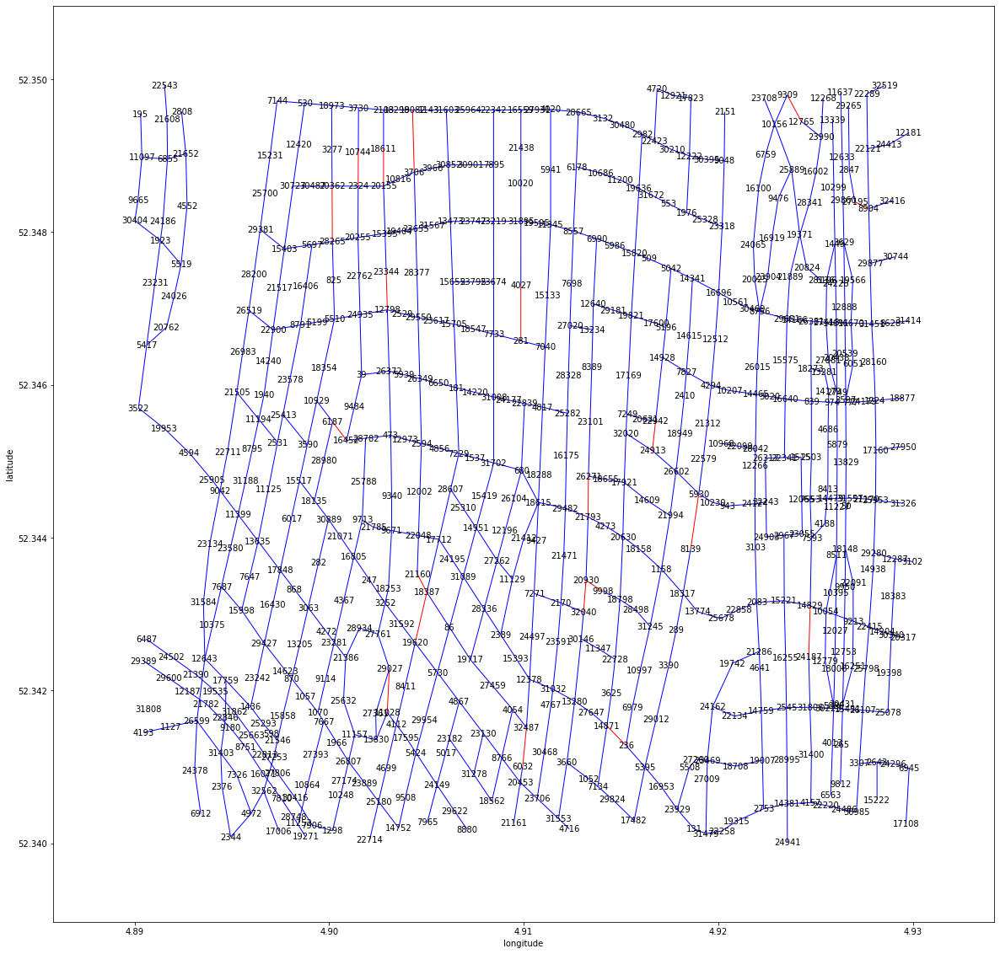

In [30]:

plot_graph(G12_d, figsize=(20,20), show_labels=True, fontsize=10)

In [35]:
# Read mismatches trajectories
with open('./hmm_mismatches/saved_paths.hdf5', 'rb') as handle:
    mismatches = pkl.load(handle)
    
# Load the removed edges
dataset = SHDataset(noise=False, dataset_dir='./dataset/')
G1,T1,G2,T2 = dataset.read_snapshots(0)
G1,T1,G2,T2 = filter_bbox_snapshots(G1,T1,G2,T2, (52.34, 52.35, 4.89, 4.93))
_, G12_d, _, _ = compare_snapshots(G1,G2)
edge_colors = nx.get_edge_attributes(G12_d, name='color')
removed_edges = [edge for edge, col in edge_colors.items() if col == 'red']

In [49]:
# Prep the change detector
# 68/266 fixed
# hmm_det = HMMChangeDetector(G1, use_latlon=True, obs_noise=50, obs_noise_ne=4, max_dist_init=200,
#                 max_dist=100, min_prob_norm=0.001, non_emitting_states=True, non_emitting_length_factor=0.75,
#                 max_lattice_width=None, dist_noise=10, dist_noise_ne=10, restrained_ne=True, avoid_goingback=True,
#                 enable_pbar=True)

# 209/266 fixed
# hmm_det = HMMChangeDetector(G1, use_latlon=True, obs_noise=4, obs_noise_ne=4, max_dist_init=100,
#                 max_dist=100, min_prob_norm=0.001, non_emitting_states=True, non_emitting_length_factor=0.75,
#                 max_lattice_width=None, dist_noise=10, dist_noise_ne=10, restrained_ne=True, avoid_goingback=True,
#                 enable_pbar=True)

# 219/266 fixed
# hmm_det = HMMChangeDetector(G1, use_latlon=False, obs_noise=4, obs_noise_ne=4, max_dist_init=100,
#                 max_dist=100, min_prob_norm=0.001, non_emitting_states=True, non_emitting_length_factor=0.75,
#                 max_lattice_width=None, dist_noise=10, dist_noise_ne=10, restrained_ne=True, avoid_goingback=True,
#                 enable_pbar=True)

Found 15 fixes: : 20it [00:08,  2.98it/s]/home/waller/Documents/LatestRepo/SyntheticHighways/ChangeDetection/utils.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize)
Found 219 fixes: : 266it [01:27,  3.04it/s]


219/266 trajectories have been fixed st they dont traverse removed edges


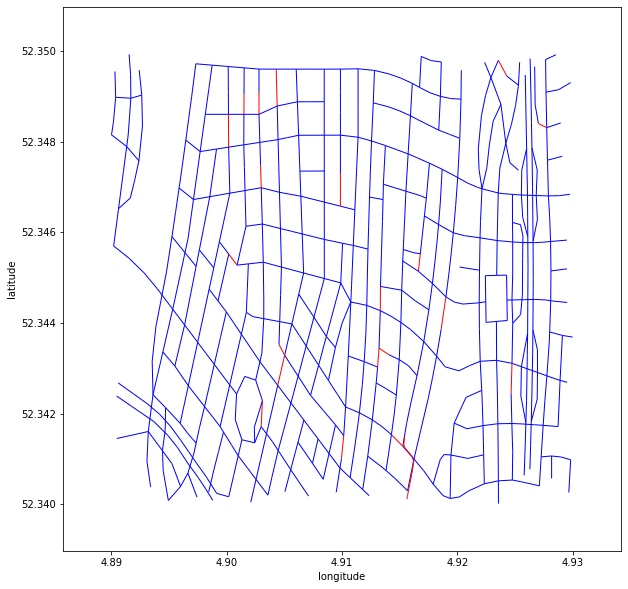

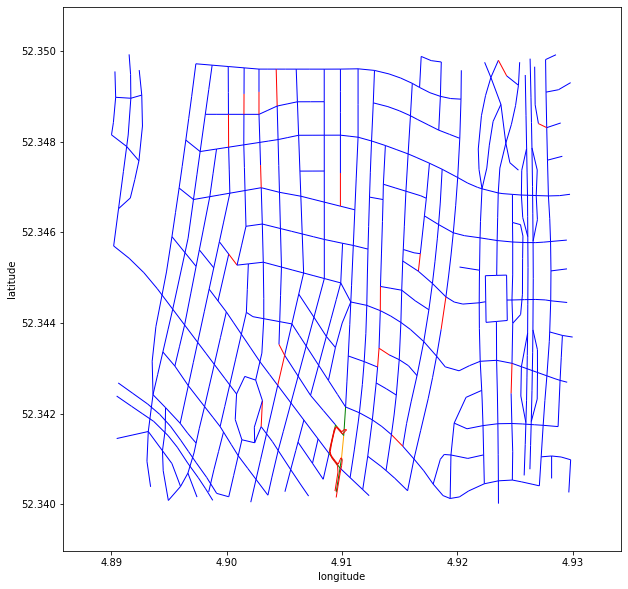

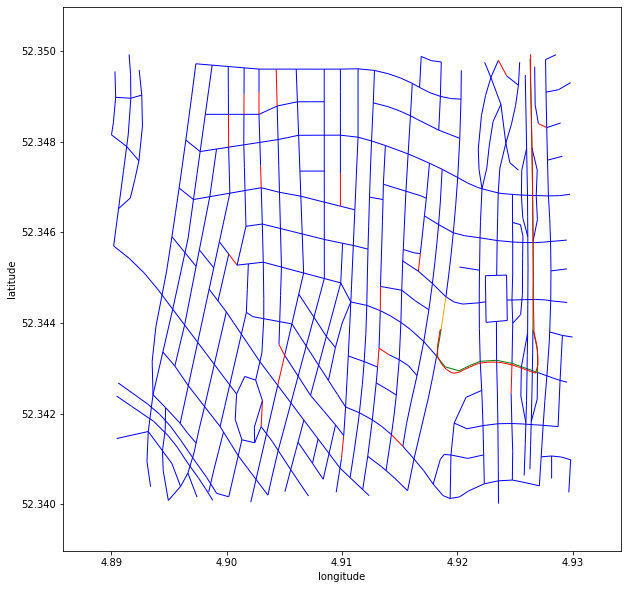

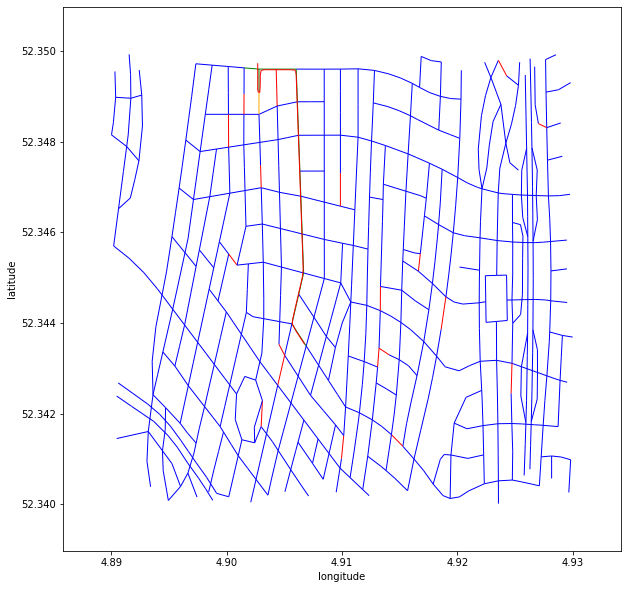

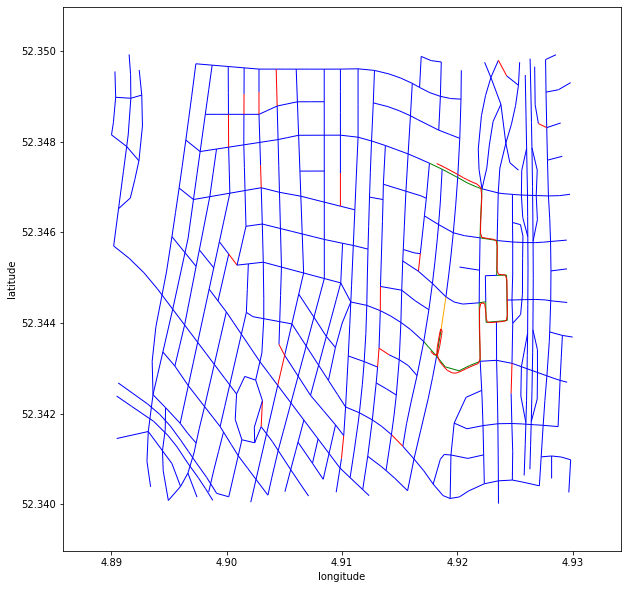

...

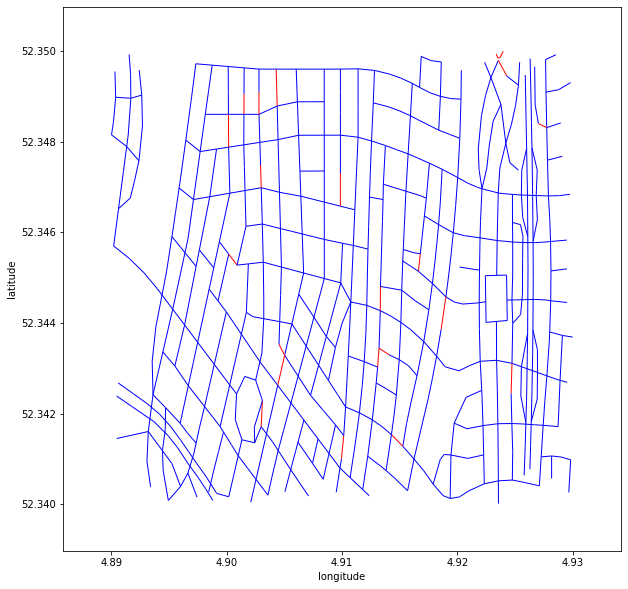

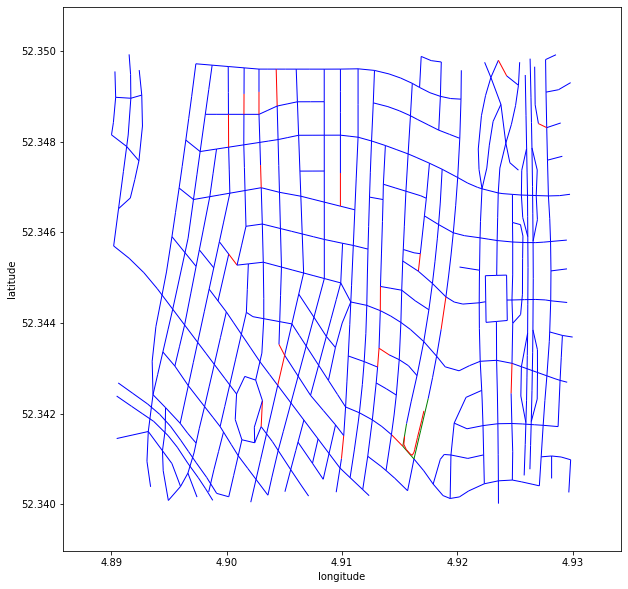

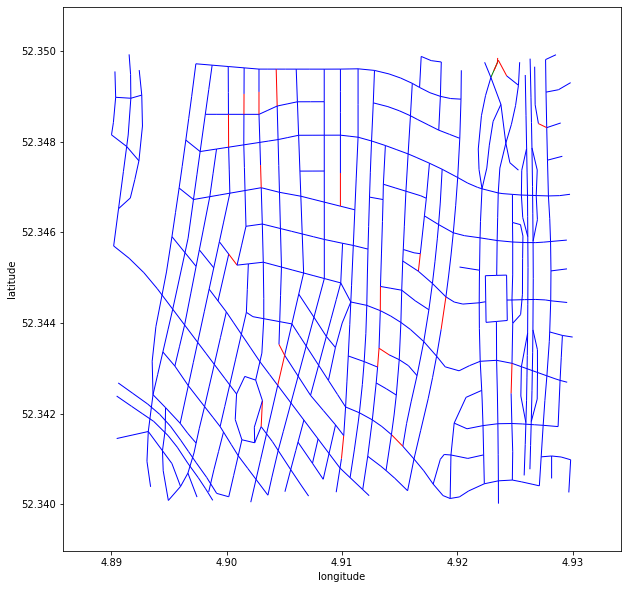

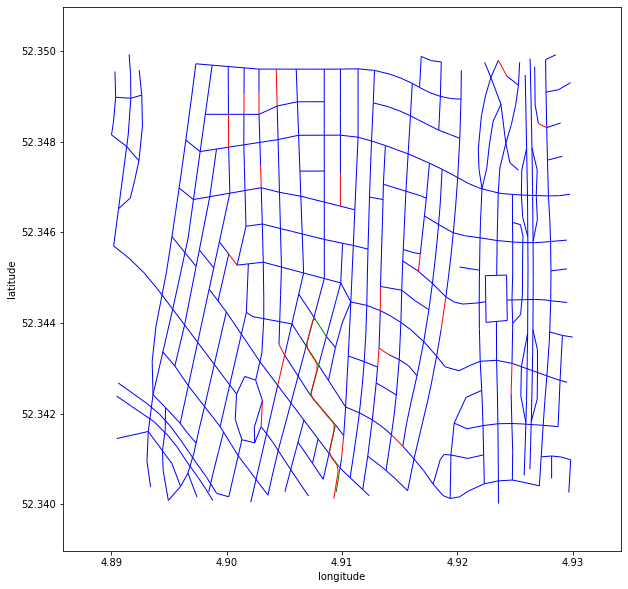

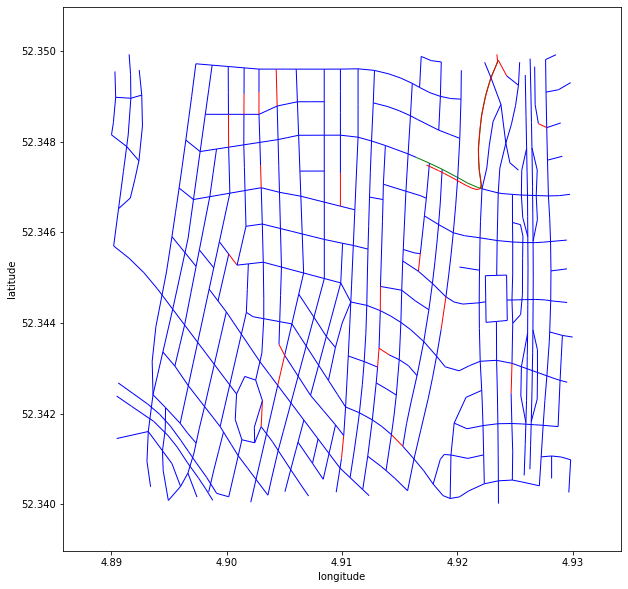

In [50]:

fixed = []

from tqdm import tqdm
pbar = tqdm(enumerate(mismatches))
for i, (t, path) in pbar:
    path = hmm_det.map_match_trajectory(t)
    G = G12_d.copy()
    mismatched_edges = [edge for edge in path if edge in removed_edges]
    if len(mismatched_edges) == 0:
        fixed.append(i)
    pbar.set_description(f'Found {len(fixed)} fixes')
    mismatched_colors = {edge: 'orange' for edge in mismatched_edges}
    path_cols = {edge: 'green' for edge in path if edge not in removed_edges}
    nx.set_edge_attributes(G, path_cols, name='color')
    nx.set_edge_attributes(G, mismatched_colors, name='color')
    plot_graph(snapshot_to_nxgraph(G, [t]), figsize=(10,10), show_img=False, savename=f'./hmm_mismatches/mismatch_{i}_rematched')

print(f'{len(fixed)}/{len(mismatches)} trajectories have been fixed st they dont traverse removed edges')

In [40]:

hmm_det = HMMChangeDetector(G1, use_latlon=True, obs_noise=4, obs_noise_ne=4, max_dist_init=100,
                max_dist=100, min_prob_norm=0.001, non_emitting_states=True, non_emitting_length_factor=0.75,
                max_lattice_width=None, dist_noise=10, dist_noise_ne=10, restrained_ne=True, avoid_goingback=True,
                enable_pbar=True)

fixed = []

from tqdm import tqdm
pbar = tqdm(enumerate(mismatches))
for i, (t, path) in pbar:
    path = hmm_det.map_match_trajectory(t)
    G = G12_d.copy()
    mismatched_edges = [edge for edge in path if edge in removed_edges]
    if len(mismatched_edges) == 0:
        fixed.append(i)
    pbar.set_description(f'Found {len(fixed)} fixes')
    mismatched_colors = {edge: 'orange' for edge in mismatched_edges}
    path_cols = {edge: 'green' for edge in path if edge not in removed_edges}
    nx.set_edge_attributes(G, path_cols, name='color')
    nx.set_edge_attributes(G, mismatched_colors, name='color')
    plot_graph(snapshot_to_nxgraph(G, [t]), figsize=(10,10), show_img=False, savename=f'./hmm_mismatches/mismatch_{i}_rematched')

print(f'{len(fixed)}/{len(mismatches)} trajectories have been fixed st they dont traverse removed edges')

[137, 160, 229]